# **Assignment-3 (Model interpretability)**

**Abstract**- The aim of this assignment is to develop a prediction model to determine if a person is suffering from diabetes or not based on some predicted variables/independent variable.

In this notebook we will perform following activities.
1.Fit a linear model and interpret nodes.

2.Fit a tree-based model and interpret the nodes

3.Use auto ml to find the best model

4.Run SHAP analysis on the models from steps 1, 2, and 3,interpret the SHAP values and compare them with the other model interpretability methods.


**Dataset Overview**
The dataset at hand offers a rich collection of features, encapsulating the dynamics of pizza sales. Key columns include:

**Pizza Attributes:**

pizza_id: Identifier for different types of pizzas. pizza_name_id: A unique combination of pizza name and size. pizza_size: Categorization of pizzas based on size. pizza_category: Classification of pizzas into various categories. pizza_ingredients: List of ingredients used in each pizza. pizza_name: Name of the pizza.

**Order Details:**

order_id: Unique identifier for each order. quantity: Number of pizzas ordered per transaction. order_date & order_time: Timestamps providing temporal context to each order.

**Pricing Information:**

unit_price: Price of a single unit of pizza. total_price: Total price for the order, serving as the target variable for our analysis.

**Summary**

1)In below code we will begin with impoting various libraries needed during the implementations and after that we will look for the data in dataset using .head command and then split the data in test and train cases for both predicted variable and independent variable and then will implement linear regression and will find which variable has highest importance and which one has least importance for determining the final outcome.

2)Secondly we will implement same steps of splitting data into training and test data and further we will use Xgboost to implement decision tree algorithm and will find the least and most important variable for determining the dependent variable.

3)Third we will install h20 ,initialise it on our dataset and further will find best fit algorithm for the dataset.

4)In the end we will apply shap analysis in all the above 3 tests and will find if all of them are giving same outcomes or different outcome.

Some installations further needed in the assignment
The pydotplus library is a Python interface to Graphviz's Dot language. It is often used in conjunction with other libraries, such as scikit-learn or networkx, for visualizing decision trees, graphs, and other structures.

If we're working with decision trees, for example, we might use pydotplus to visualize the tree generated by a machine learning model and in this assignment we are using decion tree and random forest.


In [ ]:
pip install pydotplus

In [ ]:
#data manupulation
import pandas as pd
#numerical combination
import numpy as np
#plotting data and create visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from plotly.subplots import make_subplots
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from sklearn.tree import plot_tree
import pydotplus #pip install pydotplus
from sklearn.tree import export_graphviz
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score, confusion_matrix
from sklearn import metrics

from statsmodels.stats.outliers_influence import variance_inflation_factor

import xgboost as xgb
from xgboost import plot_importance

In [ ]:
data = pd.read_csv('/content/label_encoded_dataset.csv')

# **Data Checking**

In [ ]:
data.head(10)

,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
0,1201,1.0,4,11,13.25,13.25,1,1,2370,12
1,701,1.0,4,11,16.00,16.00,1,1,2416,7
2,800,1.0,4,11,18.50,18.50,0,3,1359,8
3,1400,1.0,4,11,20.75,20.75,0,2,1849,14
4,1701,1.0,4,11,16.00,16.00,1,3,1456,17
5,3000,1.0,4,11,20.75,20.75,0,0,2315,30
6,1401,1.0,4,12,16.50,16.50,1,2,1849,14
7,2200,1.0,4,12,20.75,20.75,0,2,1428,22
8,1401,1.0,4,12,16.50,16.50,1,2,1849,14
9,1401,1.0,4,12,16.50,16.50,1,2,1849,14


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48620 entries, 0 to 48619
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   pizza_name_id      48620 non-null  int64  
 1   quantity           48620 non-null  float64
 2   order_date         48620 non-null  int64  
 3   order_time         48620 non-null  int64  
 4   unit_price         48620 non-null  float64
 5   total_price        48620 non-null  float64
 6   pizza_size         48620 non-null  int64  
 7   pizza_category     48620 non-null  int64  
 8   pizza_ingredients  48620 non-null  int64  
 9   pizza_name         48620 non-null  int64  
dtypes: float64(3), int64(7)
memory usage: 3.7 MB


In [ ]:
data.describe()

,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
count,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000,48620.000000
mean,1552.243994,1.019622,2.934369,15.911806,16.494132,16.821474,0.933834,1.490745,1704.109255,15.513102
std,932.947049,0.143077,2.033692,3.149836,3.621789,4.437398,0.846981,1.079711,517.757133,9.330179
min,0.000000,1.000000,0.000000,9.000000,9.750000,9.750000,0.000000,0.000000,480.000000,0.000000
25%,702.000000,1.000000,1.000000,13.000000,12.750000,12.750000,0.000000,1.000000,1406.000000,7.000000
50%,1502.000000,1.000000,3.000000,16.000000,16.500000,16.500000,1.000000,1.000000,1811.000000,15.000000
75%,2302.000000,1.000000,5.000000,18.000000,20.250000,20.500000,2.000000,2.000000,2302.000000,23.000000
max,3102.000000,4.000000,6.000000,23.000000,35.950000,83.000000,4.000000,3.000000,2416.000000,31.000000


In [ ]:
data.isnull().sum()

pizza_name_id        0
quantity             0
order_date           0
order_time           0
unit_price           0
total_price          0
pizza_size           0
pizza_category       0
pizza_ingredients    0
pizza_name           0
dtype: int64

# **Splitting the data into training and testing dataset**

In [ ]:
y= data.total_price

In [ ]:
x=data.drop('total_price',axis=1)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2)

# **Linear model building using Linear Regression**


In [ ]:
from sklearn.linear_model import LinearRegression

# Initialize Linear Regression model
linear_reg = LinearRegression()

# Fit the model
linear_reg.fit(x_train, y_train)

LinearRegression()

In above code we have fit the model to the training data using the fit method, where x_train is the feature matrix and y_train is the target variable

In [ ]:
coefficients = linear_reg.coef_

# Create a DataFrame to display coefficients along with feature names
coefficients_df = pd.DataFrame(coefficients, columns=['Coefficient'], index=x_train.columns)

# Sort the coefficients by magnitude (absolute value) for better visualization
coefficients_df['Abs_Coefficient'] = abs(coefficients_df['Coefficient'])
coefficients_df = coefficients_df.sort_values(by='Abs_Coefficient', ascending=False)

# Display the DataFrame
print(coefficients_df)

                    Coefficient  Abs_Coefficient
quantity           1.666427e+01     1.666427e+01
unit_price         1.017368e+00     1.017368e+00
pizza_size        -6.749685e-03     6.749685e-03
pizza_category    -2.471739e-03     2.471739e-03
order_date        -1.898054e-03     1.898054e-03
order_time        -2.184830e-04     2.184830e-04
pizza_name         6.762375e-05     6.762375e-05
pizza_name_id      1.268938e-05     1.268938e-05
pizza_ingredients  6.058183e-07     6.058183e-07


In [ ]:
lin_odds = linear_reg.coef_[0]
pd.DataFrame(lin_odds,
             x_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
pizza_name_id,0.000013
quantity,0.000013
order_date,0.000013
order_time,0.000013
unit_price,0.000013
pizza_size,0.000013
pizza_category,0.000013
pizza_ingredients,0.000013
pizza_name,0.000013


In [ ]:
odds = np.exp(linear_reg.coef_[0])
pd.DataFrame(odds,
             x_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
pizza_name_id,1.000013
quantity,1.000013
order_date,1.000013
order_time,1.000013
unit_price,1.000013
pizza_size,1.000013
pizza_category,1.000013
pizza_ingredients,1.000013
pizza_name,1.000013


We are calculating and displaying the odds ratios of the features in our linear regression model. The code provided uses NumPy and pandas to compute and display the odds ratios.



# **Tree based model building using XGBoost.**



In [ ]:
import xgboost as xgb
from xgboost import XGBRegressor

# Initialize XGBoost Regressor
xgb_reg = XGBRegressor(random_state=0)

# Fit the model
xgb_reg.fit(x_train, y_train)


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

1)import the XGBClassifier class from the xgboost library.

2)Create an instance of the XGBClassifier model. This initializes the XGBoost model with default parameters. we can customize the parameters based on your specific needs and the nature of our dataset.

3)Fit the model to the training data using the fit method, where x_train is the feature matrix, and y_train is the target variable.

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score# Predict on the test set
preds = xgb_reg.predict(x_test)

# Evaluate the model
mse = mean_squared_error(y_test, preds)
r2 = r2_score(y_test, preds)

print("Mean Squared Error:", mse)
print("R-squared:", r2)

Mean Squared Error: 6.574382097324671e-05
R-squared: 0.999996732357782


We're using the XGBoost regressor (xgb_reg) to make predictions on the test set (x_test) and then evaluating the accuracy of the predictions using the accuracy_score function.

The Mean Squared Error is 6.574382097324671e-05 and
R-squared is 0.999996732357782

**Fit the tree model and interpret the nodes-**
Fit a tree-based model and interpret the nodes Ans: The plot below interprets all nodes (root, leaf, and intermediate) and displays the first tree plotted with the XGBoost algorithm. This figure shows how the model arrived at its final decisions and what splits it took to reach those results. As per the below plot, the root node is 'toatl_price'. Node interpretability for first 3 trees is shown below.

**First tree plotted with XGBoost algorithm.**

<Figure size 5000x5000 with 0 Axes>

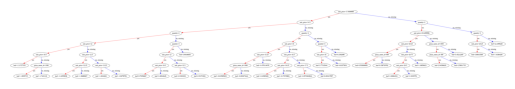

In [ ]:
# Set the size of the figure
plt.figure(figsize=(50, 50))
xgb.plot_tree(xgb_reg,num_trees=0)
plt.show()

**Second tree plotted with XGBoost algorithm.**


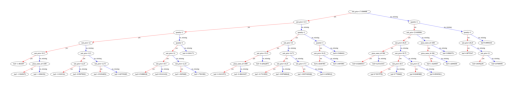

In [ ]:
xgb.plot_tree(xgb_reg,num_trees=1)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

**Third tree plotted with XGBoost algorithm.**


In [ ]:
xgb.plot_tree(xgb_reg,num_trees=2)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

# **Using AutoML to find the best model.**


In [ ]:
pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 3.9 MB/s eta 0:00:00


In [ ]:
# Import libraries
# Use pip install or conda install if missing a library
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
import matplotlib.pyplot as plt
from h2o.estimators.random_forest import H2ORandomForestEstimator

In [ ]:
# Set a minimum memory size and a run time in seconds
min_mem_size=6
run_time=222

In [ ]:
# Use 50% of availible resources
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))
print(min_mem_size)

6


This above code calculates the min_mem_size (minimum memory size) based on a percentage (pct_memory) of the available virtual memory on the system using the psutil library.



In [ ]:
# 65535 Highest port no
# Start the H2O server on a random port
port_no=random.randint(5555,55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
except:
  logging.critical('h2o.init')
  h2o.download_all_logs(dirname=logs_path, filename=logfile)
  h2o.cluster().shutdown()
  sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:45858..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpq7pjedkb
  JVM stdout: /tmp/tmpq7pjedkb/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpq7pjedkb/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:45858
Connecting to H2O server at http://127.0.0.1:45858 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,4 days
H2O_cluster_name:,H2O_from_python_unknownUser_bcvd6q
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,6 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


This above code snippet is attempting to start an H2O server with a randomly chosen port number in the range of 5555 to 55555 using the h2o.init function in Python. If an exception occurs during initialization, it logs the error, downloads all logs, shuts down the H2O cluster, and exits the script with a status code of 2.



In [ ]:
data = h2o.import_file( '/content/label_encoded_dataset.csv' )

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
data.head()

pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
1201,1,4,11,13.25,13.25,1,1,2370,12
701,1,4,11,16,16,1,1,2416,7
800,1,4,11,18.5,18.5,0,3,1359,8
1400,1,4,11,20.75,20.75,0,2,1849,14
1701,1,4,11,16,16,1,3,1456,17
3000,1,4,11,20.75,20.75,0,0,2315,30
1401,1,4,12,16.5,16.5,1,2,1849,14
2200,1,4,12,20.75,20.75,0,2,1428,22
1401,1,4,12,16.5,16.5,1,2,1849,14
1401,1,4,12,16.5,16.5,1,2,1849,14


In [ ]:
data.types

{'pizza_name_id': 'int',
 'quantity': 'int',
 'order_date': 'int',
 'order_time': 'int',
 'unit_price': 'real',
 'total_price': 'real',
 'pizza_size': 'int',
 'pizza_category': 'int',
 'pizza_ingredients': 'int',
 'pizza_name': 'int'}

In [ ]:
import pandas as pd
import h2o

# Convert H2OFrame to Pandas DataFrame
data_pd = data.as_data_frame()

# Convert 'unit_price' and 'total_price' columns to integer data type
data_pd['unit_price'] = data_pd['unit_price'].astype(int)
data_pd['total_price'] = data_pd['total_price'].astype(int)

# Convert back to H2OFrame
data = h2o.H2OFrame(data_pd)

# Check the data types after conversion
print(data.types)

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
{'pizza_name_id': 'int', 'quantity': 'int', 'order_date': 'int', 'order_time': 'int', 'unit_price': 'int', 'total_price': 'int', 'pizza_size': 'int', 'pizza_category': 'int', 'pizza_ingredients': 'int', 'pizza_name': 'int'}


In [ ]:
# Assuming 'data' is an H2OFrame object
data['total_price'] = data['total_price'].asfactor()

# Check if the column is now a factor
print(data['total_price'].isfactor())


[True]


1)data['total_price'].asfactor(): This converts the 'total_price' column in the H2O data frame (data) to a factor type. Factors are categorical variables in H2O.

2)print(data['total_price'].isfactor()): This prints whether the 'total_price' column is a factor or not. The isfactor() method returns a boolean indicating whether the column is a factor.



In [ ]:
data.describe()

Rows:48620
Cols:10

,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
type,int,int,int,int,int,enum,int,int,int,int
mins,0.0,1.0,0.0,9.0,9.0,,0.0,0.0,480.0,0.0
mean,1552.2439942410474,1.0196215549156642,2.9343685726038458,15.911805841217559,16.03730974907454,,0.9338338132455783,1.4907445495680738,1704.1092554504385,15.51310160427802
maxs,3102.0,4.0,6.0,23.0,35.0,,4.0,3.0,2416.0,31.0
sigma,932.9470489957058,0.14307700932472173,2.033692479505859,3.149836090733785,3.514366913448895,,0.8469810004831723,1.0797108029426314,517.7571334125616,9.330178767818236
zeros,967,0,8106,0,0,,18526,10815,0,2372
missing,0,0,0,0,0,0,0,0,0,0
0,1201.0,1.0,4.0,11.0,13.0,13,1.0,1.0,2370.0,12.0
1,701.0,1.0,4.0,11.0,16.0,16,1.0,1.0,2416.0,7.0
2,800.0,1.0,4.0,11.0,18.0,18,0.0,3.0,1359.0,8.0


In [ ]:
data.shape

(48620, 10)

In [ ]:
# Create a 80/20 train/test split
pct_rows=0.80
data_train, data_test = data.split_frame([pct_rows])

In [ ]:
print(data_train.shape)
print(data_test.shape)

(38962, 10)
(9658, 10)


In [ ]:
data_train.head(2)

pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
1201,1,4,11,13,13,1,1,2370,12
1400,1,4,11,20,20,0,2,1849,14


In [ ]:
# Set the features and target
X=data.columns
print(X)

['pizza_name_id', 'quantity', 'order_date', 'order_time', 'unit_price', 'total_price', 'pizza_size', 'pizza_category', 'pizza_ingredients', 'pizza_name']


In [ ]:
# Set target and predictor variables
y ='total_price'
#y_numeric ='churn_bit'
X.remove(y)
#X.remove(y_numeric)
print(X)

['pizza_name_id', 'quantity', 'order_date', 'order_time', 'unit_price', 'pizza_size', 'pizza_category', 'pizza_ingredients', 'pizza_name']


In above snippet we are working with a dataset and we are setting the target variable (y) and predictor variables (X). Additionally, it appears that we are removing the target variable from the predictor variables.



In [ ]:
# Set up AutoML
auml = H2OAutoML(max_runtime_secs=run_time, seed=1)

1)H2OAutoML is the class responsible for running the AutoML process using H2O.ai. auml is an instance of the H2OAutoML class.

2)max_runtime_secs is a parameter that sets the maximum time, in seconds, that the AutoML process is allowed to run. The AutoML will stop after this duration, and the best model found up to that point will be selected.

3)seed is a parameter that sets the random seed for reproducibility. Setting a seed ensures that the random processes within the AutoML, such as random hyperparameter searches, will be the same each time you run the AutoML with the same seed. This can be useful for reproducibility and debugging.

In [ ]:
auml.train(x=X,y=y,training_frame=data_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OXGBoostEstimator : XGBoost
Model Key: XGBoost_1_AutoML_1_20240317_224532


Model Summary: 
    number_of_trees
--  -----------------
    17

ModelMetricsMultinomial: xgboost
** Reported on train data. **

MSE: 0.006771988825545181
RMSE: 0.08229209455072328
LogLoss: 0.03702480011369273
Mean Per-Class Error: 0.4849362648087113
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
9      10     11     12      13     14     15     16       17      18      19    20       21     22    23     24     25     26    29    30    32    33     35    36    37    40    41     47    48    49    50    51    55    61    62    83    Error                 Rate
-----  -----  -----  ------  -----  -----  -----  -------  ------  ------  ----  -------  -----  ----  -----  -----  -----  ----  ----  ----  ----  -----  ----  ----  ----  ----  -----  ----  ----  ----  ----  ----  ----  ----  ----  ----  --------------------  ------------
571.0  0.0    0.0    0.0     0.0    0.0    0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 571
0.0    802.0  0.0    0.0     0.0    0.0    0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 802
0.0    0.0    457.0  0.0     0.0    0.0    0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 457
0.0    0.0    0.0    9667.0  0.0    0.0    0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 9,667
0.0    0.0    0.0    0.0     362.0  0.0    0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 362
0.0    0.0    0.0    0.0     0.0    783.0  0.0    0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 783
0.0    0.0    0.0    0.0     0.0    0.0    570.0  0.0      0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 570
0.0    0.0    0.0    0.0     0.0    0.0    0.0    10980.0  0.0     0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 10,980
0.0    0.0    0.0    0.0     0.0    0.0    0.0    0.0      1303.0  0.0     0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0                   0 / 1,303
0.0    0.0    0.0    0.0     0.0    0.0    0.0    0.0      0.0     1038.0  0.0   0.0      0.0    0.0   0.0    0.0    0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0    0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.0            

1)auml: This is your H2O AutoML object.

2)train: This method is used to initiate the training process.

3)x=X, y=y: Here, X represents the list of predictor variables, and y represents the target variable. This specifies the features (X) and the target variable (y) for training the model.

4)training_frame=data_train: This specifies the H2O frame (data_train) containing the training data. The training data includes both the predictor variables (X) and the target variable (y).



In [ ]:
print(auml.leaderboard)

model_id                                                   mean_per_class_error    logloss      rmse         mse
XGBoost_1_AutoML_1_20240317_224532                                     0.516743  0.0461088  0.092117  0.00848554
GBM_1_AutoML_1_20240317_224532                                         0.541226  0.495885   0.386711  0.149545
StackedEnsemble_BestOfFamily_1_AutoML_1_20240317_224532                0.558887  0.175759   0.133264  0.0177594
GLM_1_AutoML_1_20240317_224532                                         0.949088  1.86253    0.782037  0.611582
[4 rows x 5 columns]



The print(auml.leaderboard) statement would typically display the leaderboard of models generated by the H2O AutoML process. The leaderboard provides information about each model, such as model ID, model type, performance metrics, and other details.



In [ ]:
model_index=0
glm_index=0
glm_model=''
auml_leaderboard_df=auml.leaderboard.as_data_frame()
models_dict={}
for m in auml_leaderboard_df['model_id']:
  models_dict[m]=model_index
  if 'StackedEnsemble' not in m:
    break
  model_index=model_index+1

for m in auml_leaderboard_df['model_id']:
  if 'GLM' in m:
    models_dict[m]=glm_index
    break
  glm_index=glm_index+1
models_dict

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


{'XGBoost_1_AutoML_1_20240317_224532': 0, 'GLM_1_AutoML_1_20240317_224532': 3}

The code is used to create a dictionary `models_dict` that maps each model ID to its index in the AutoML leaderboard DataFrame. The code iterates over the rows of the AutoML leaderboard DataFrame (`auml_leaderboard_df`) and assigns an index to each model ID.

Here's a breakdown of the code:

1. `model_index` and `glm_index` are initialized to 0. These variables are used to track the index of the current model and the index of the GLM model, respectively.
2. The AutoML leaderboard DataFrame is converted to a Pandas DataFrame using the `as_data_frame()` method.
3. A loop iterates over each model ID in the leaderboard DataFrame.
4. Inside the loop:
   - Each model ID is added as a key to the `models_dict` dictionary, with its corresponding index as the value. If the model ID contains 'StackedEnsemble', the index is incremented for subsequent models.
   - If the model ID contains 'GLM', the index is assigned to `glm_index`, and the loop breaks.
5. Finally, the `models_dict` dictionary is printed.

The output of the code is the `models_dict` dictionary, which contains the model IDs as keys and their corresponding indices as values. In this specific output, there are two models: 'XGBoost_1_AutoML_1_20240317_224532' with index 0 and 'GLM_1_AutoML_1_20240317_224532' with index 3. The warning message indicates that the conversion of the H2O frame to a Pandas DataFrame is performed using single-threading, which might not be the most efficient method for large datasets.

In [ ]:
print(model_index)
best_model = h2o.get_model(auml.leaderboard[model_index,'model_id'])

0


In [ ]:
best_model.algo

'xgboost'

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_1_AutoML_1_20240317_224532

9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,29,30,32,33,35,36,37,40,41,47,48,49,50,51,55,61,62,83,Error,Rate
571.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 571
0.0,802.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 802
0.0,0.0,457.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 457
0.0,0.0,0.0,9667.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 9,667"
0.0,0.0,0.0,0.0,362.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 362
0.0,0.0,0.0,0.0,0.0,783.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 783
0.0,0.0,0.0,0.0,0.0,0.0,570.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 570
0.0,0.0,0.0,0.0,0.0,0.0,0.0,10980.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 10,980"
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1303.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 1,303"
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1038.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 1,038"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

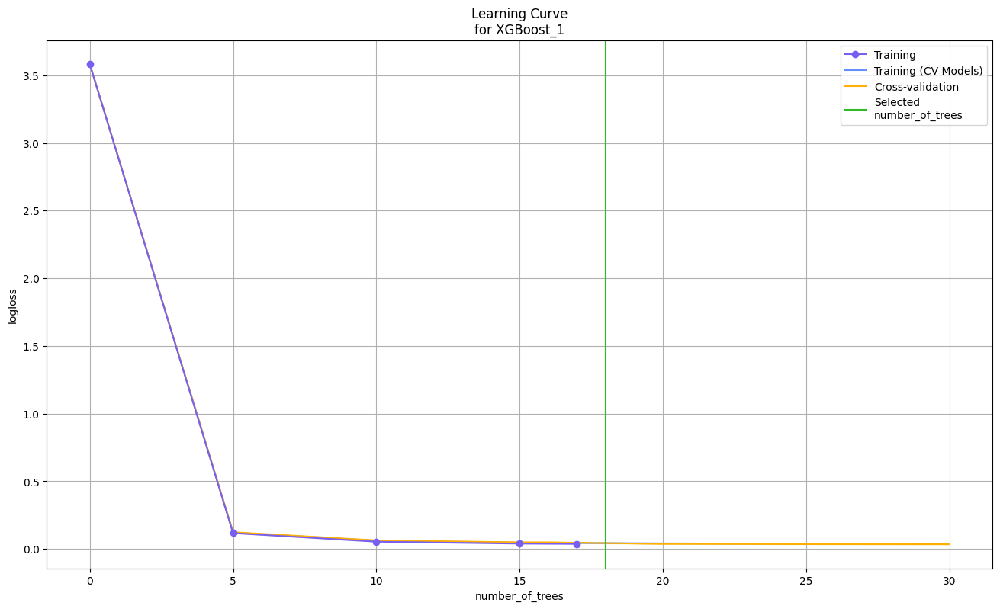

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

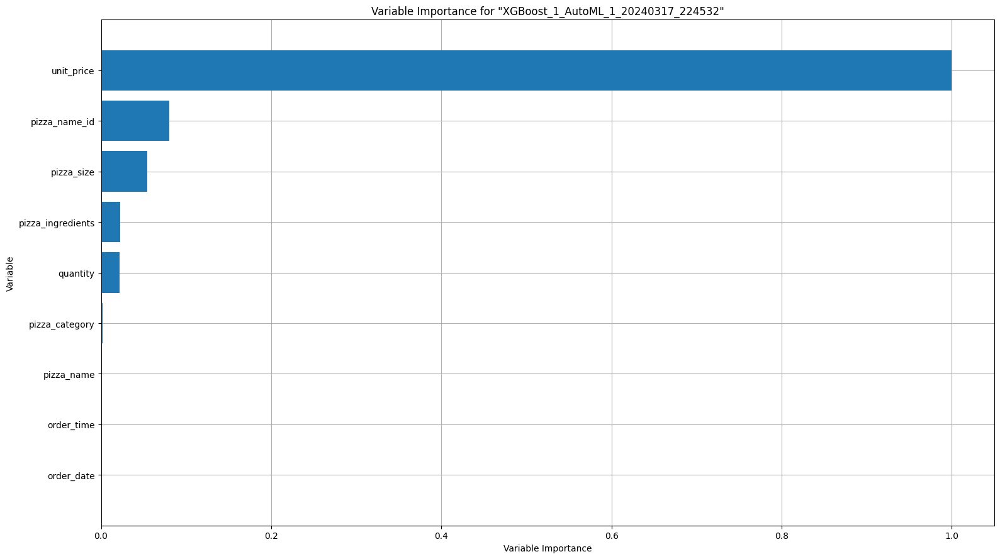

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

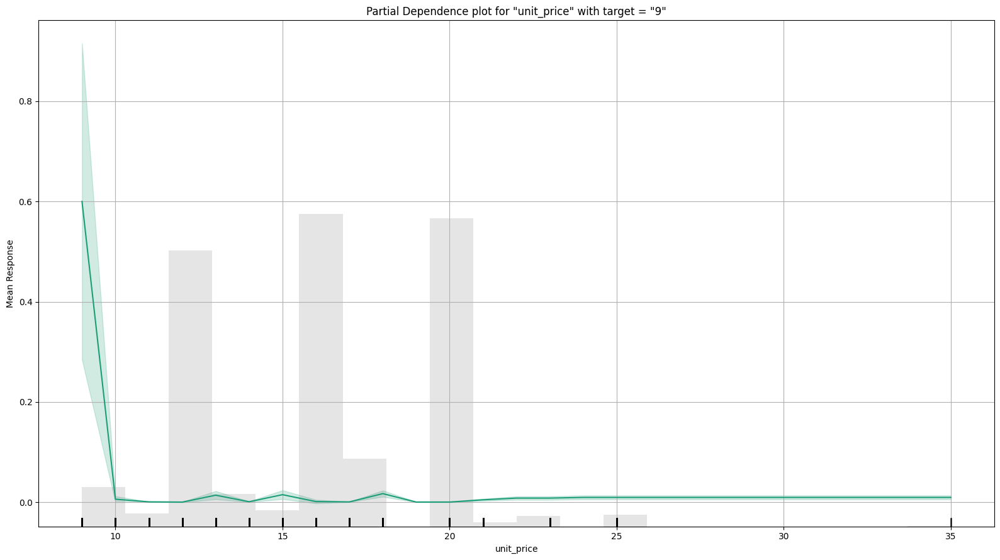

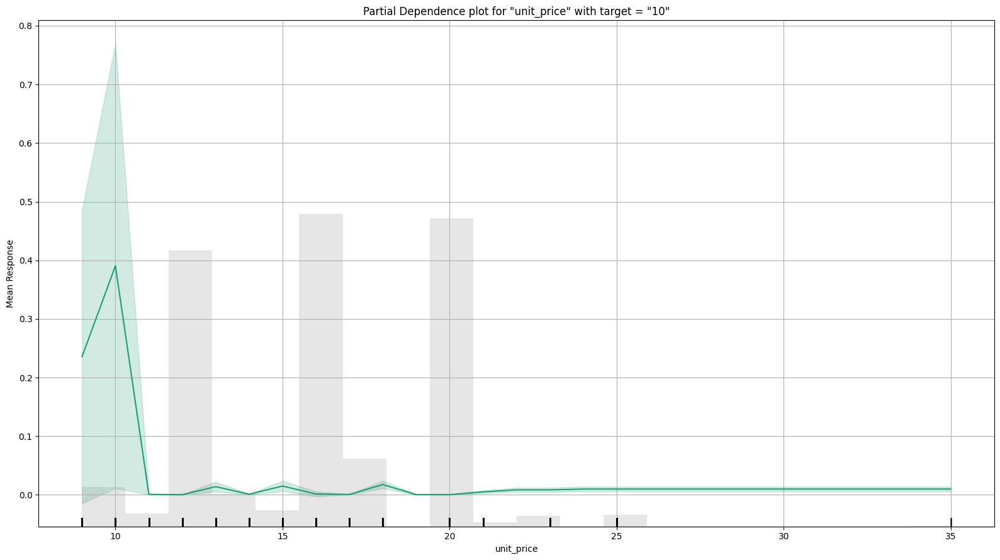

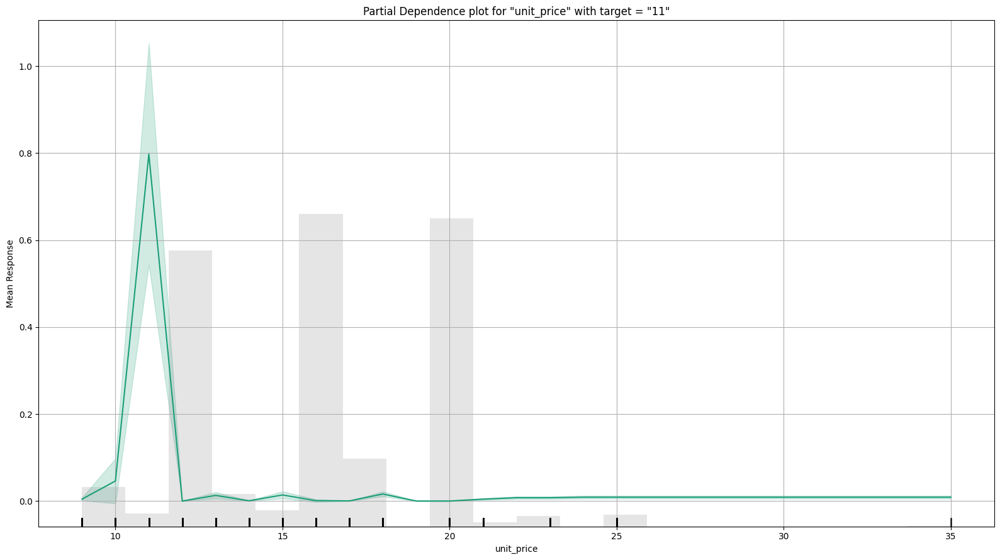

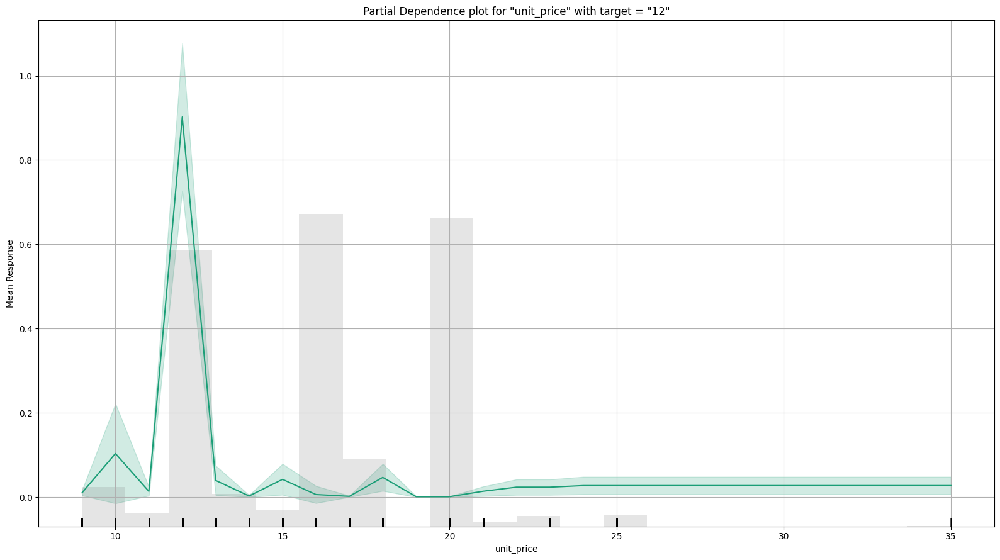

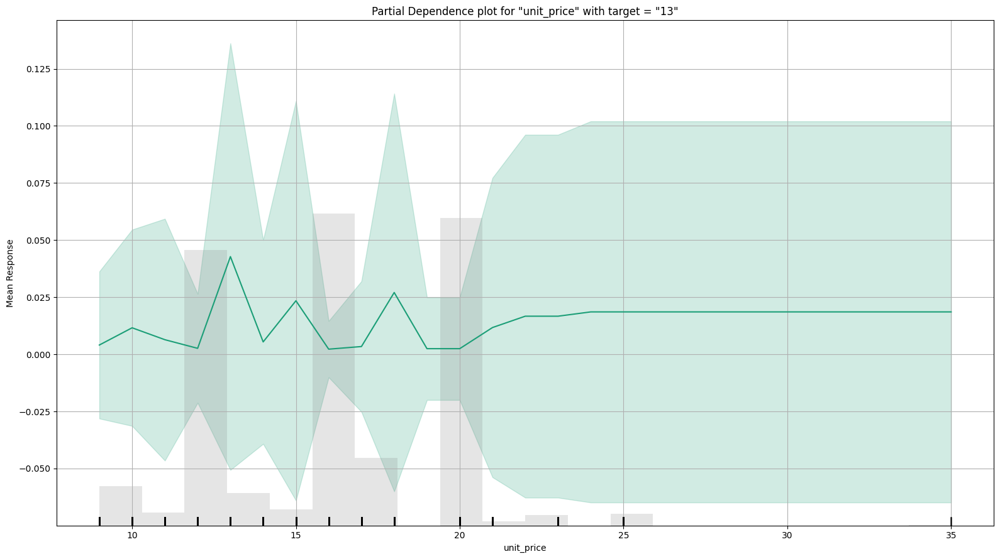

...

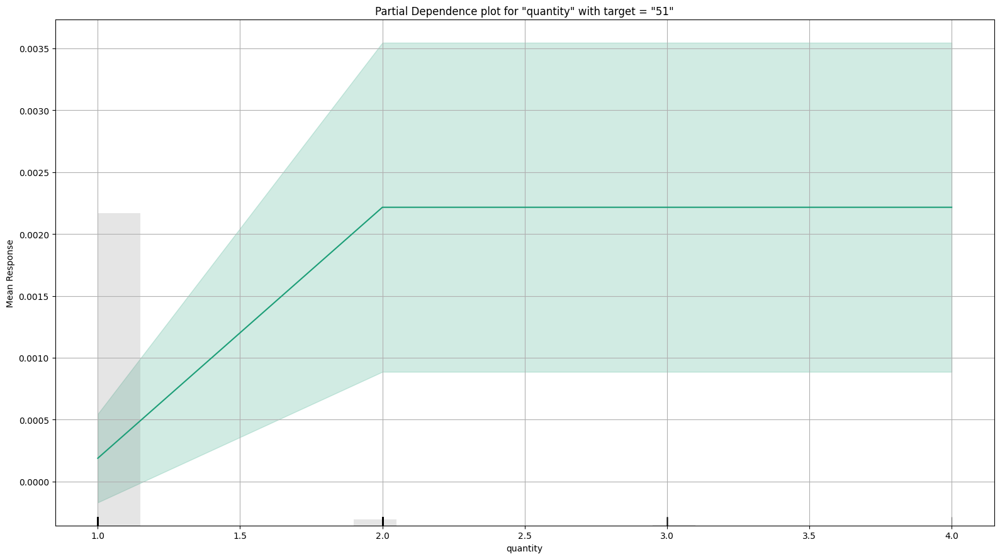

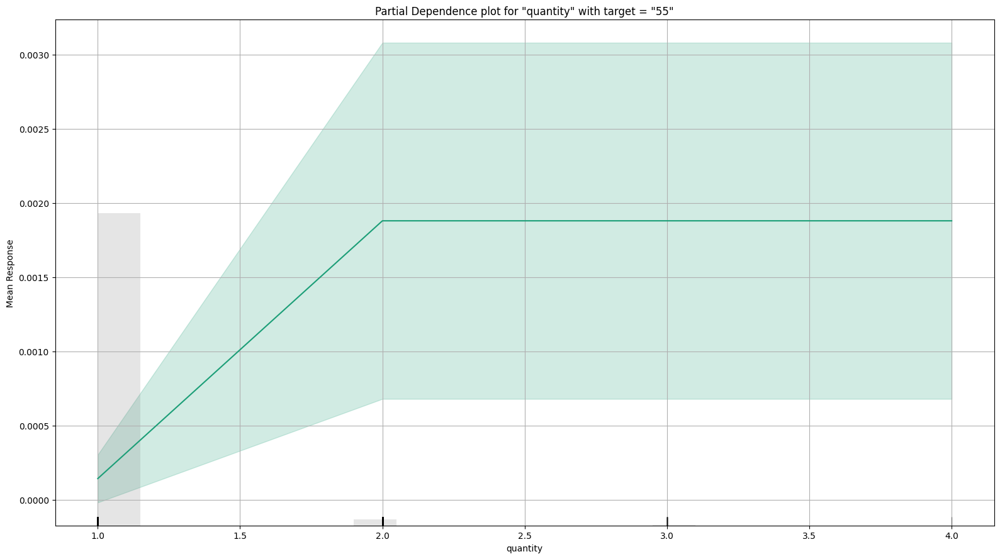

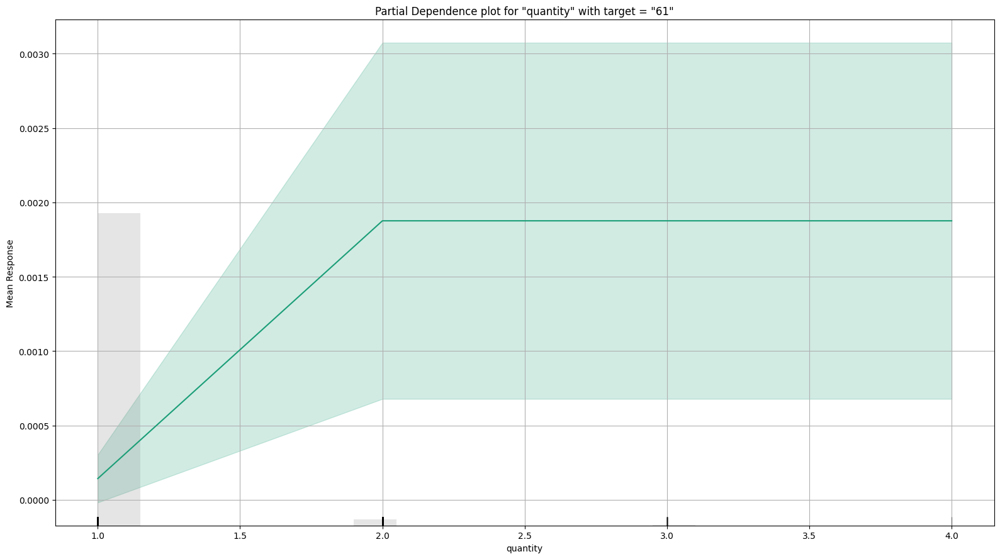

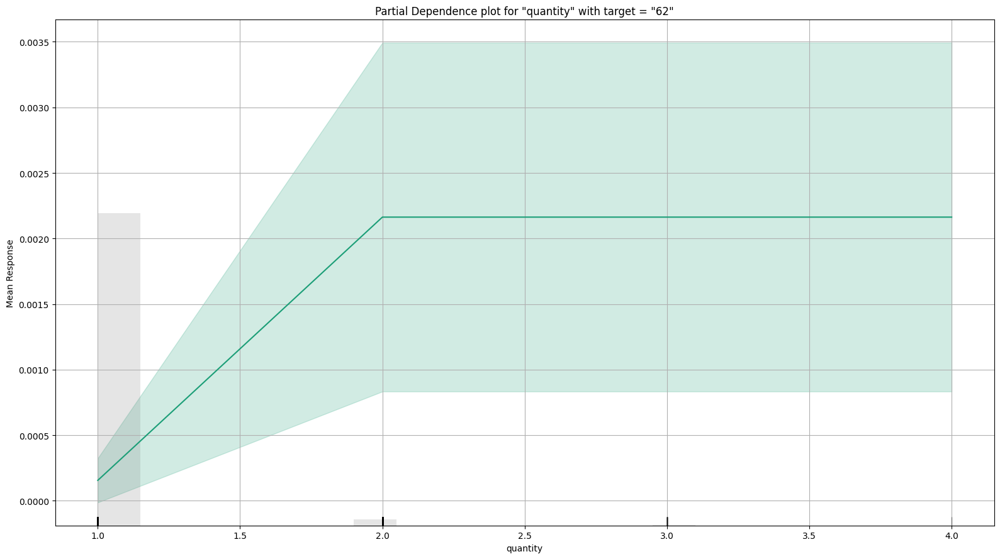

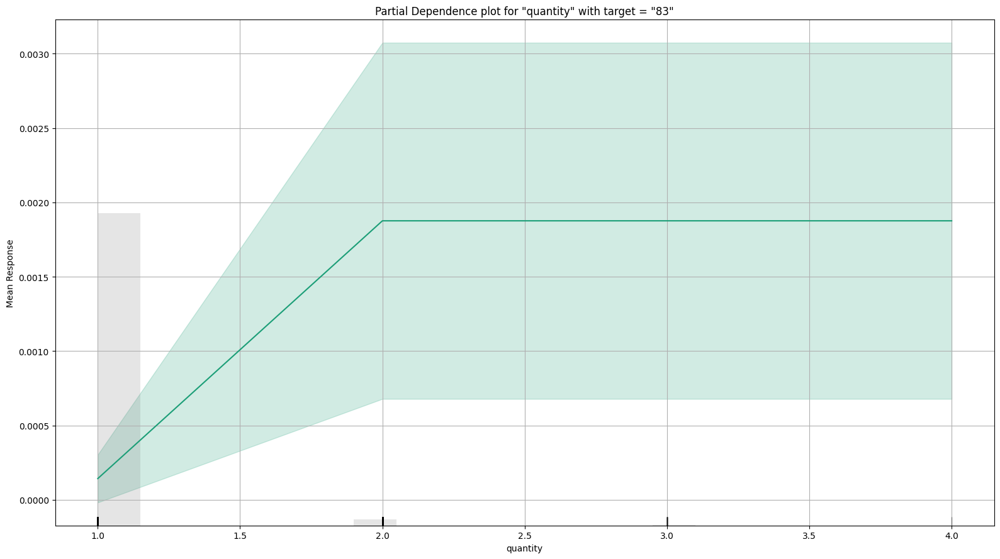

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_1_AutoML_1_20240317_224532

9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,29,30,32,33,35,36,37,40,41,47,48,49,50,51,55,61,62,83,Error,Rate
571.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 571
0.0,802.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 802
0.0,0.0,457.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 457
0.0,0.0,0.0,9667.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 9,667"
0.0,0.0,0.0,0.0,362.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 362
0.0,0.0,0.0,0.0,0.0,783.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 783
0.0,0.0,0.0,0.0,0.0,0.0,570.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 570
0.0,0.0,0.0,0.0,0.0,0.0,0.0,10980.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 10,980"
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1303.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 1,303"
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1038.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,"0 / 1,038"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

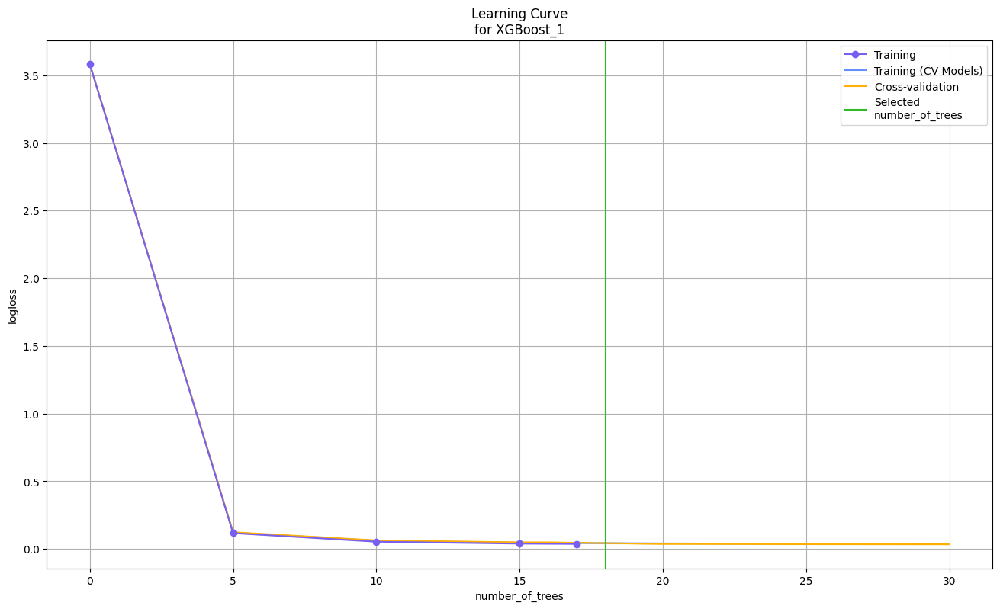

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

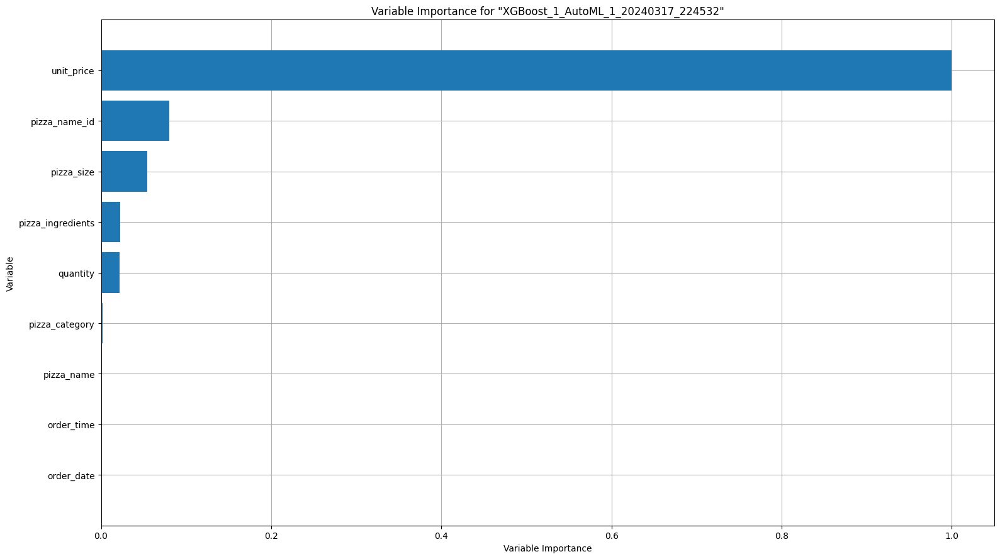

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

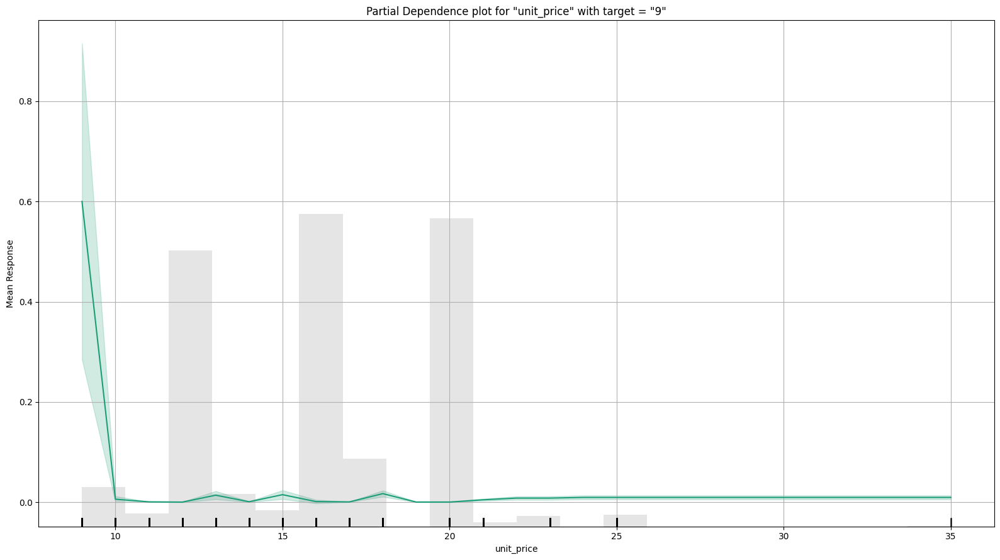

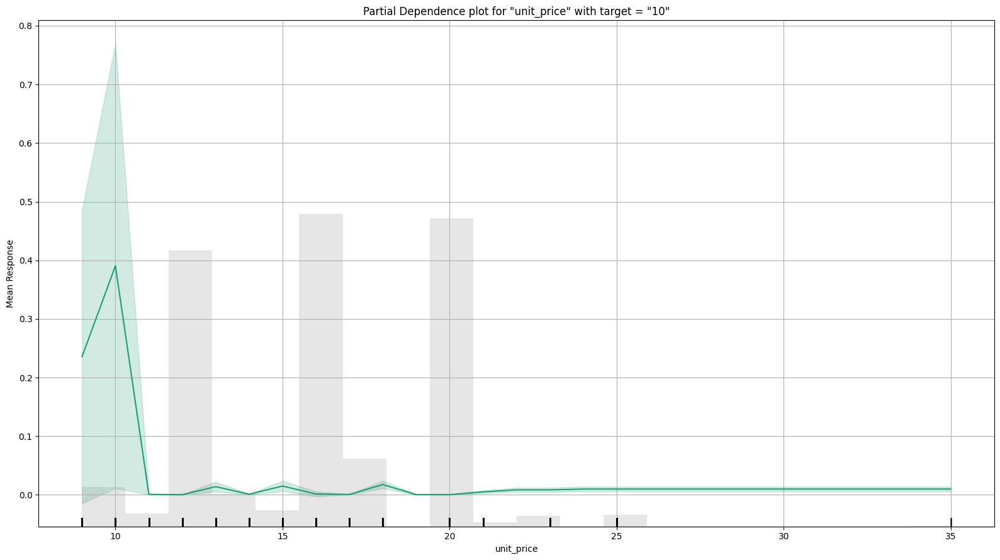

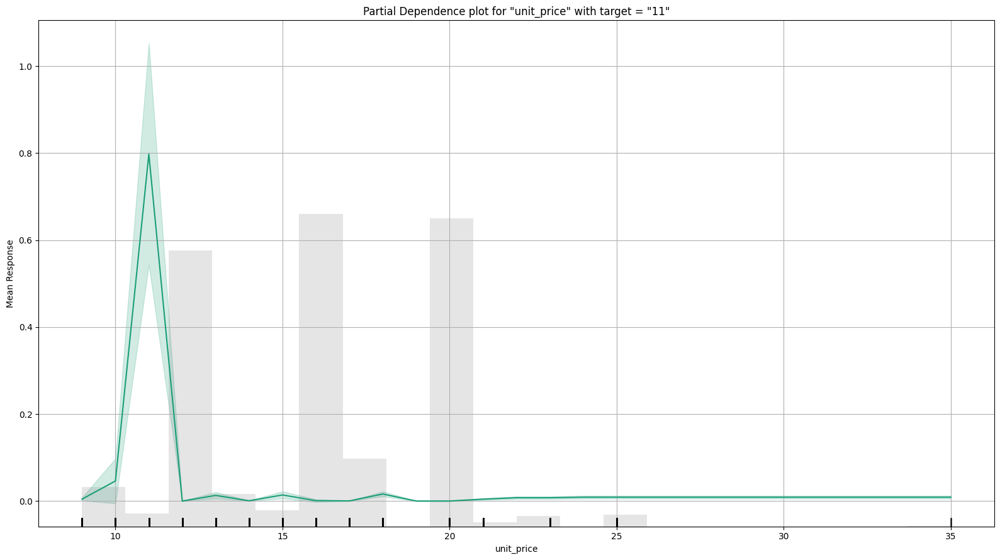

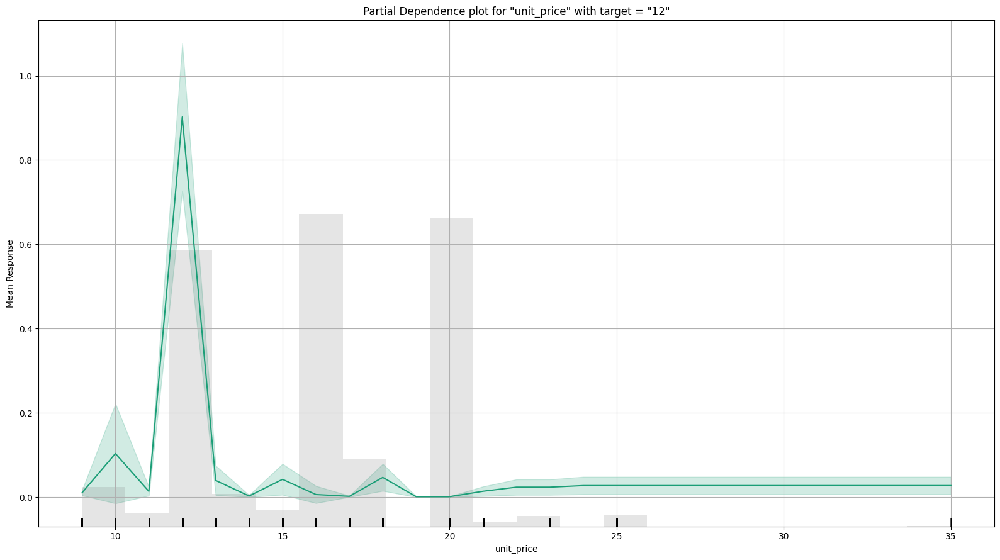

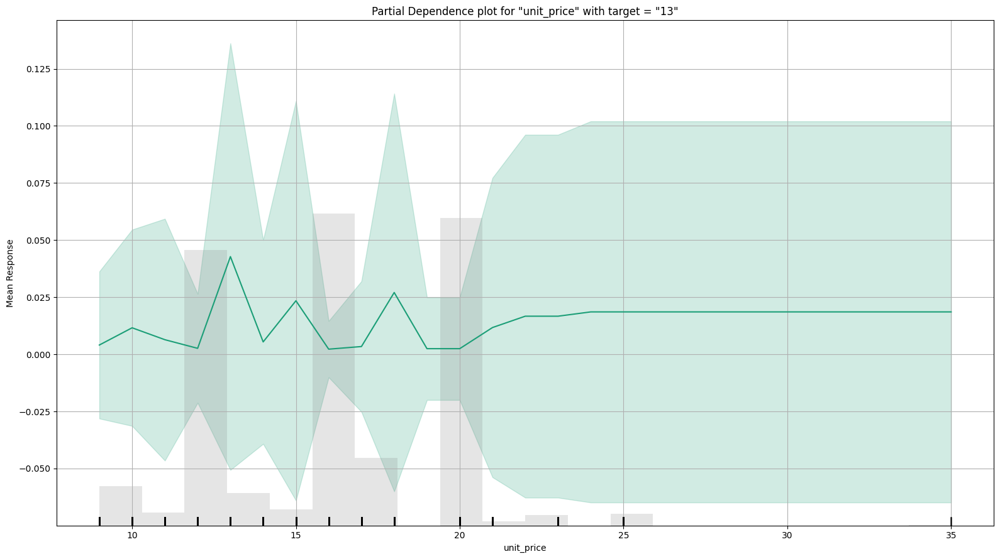

...

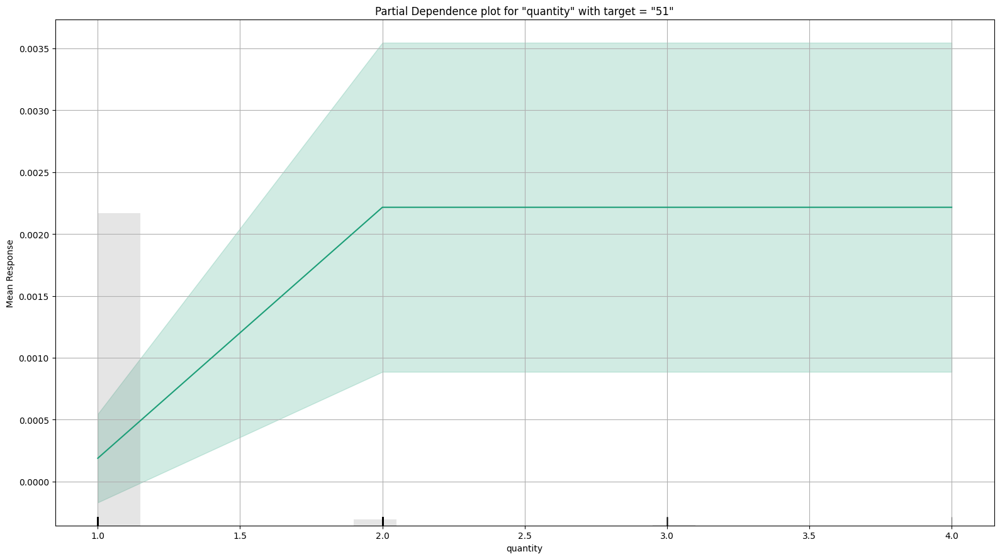

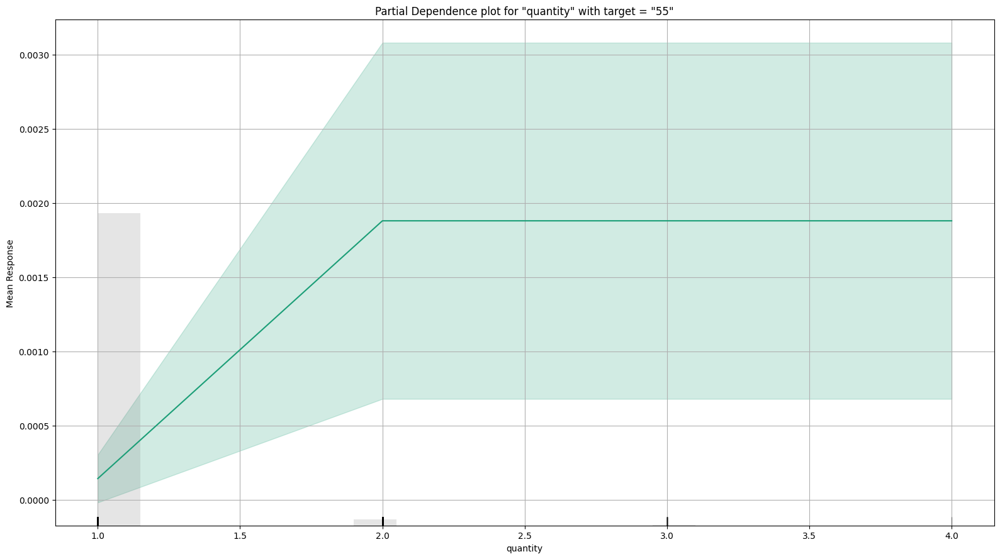

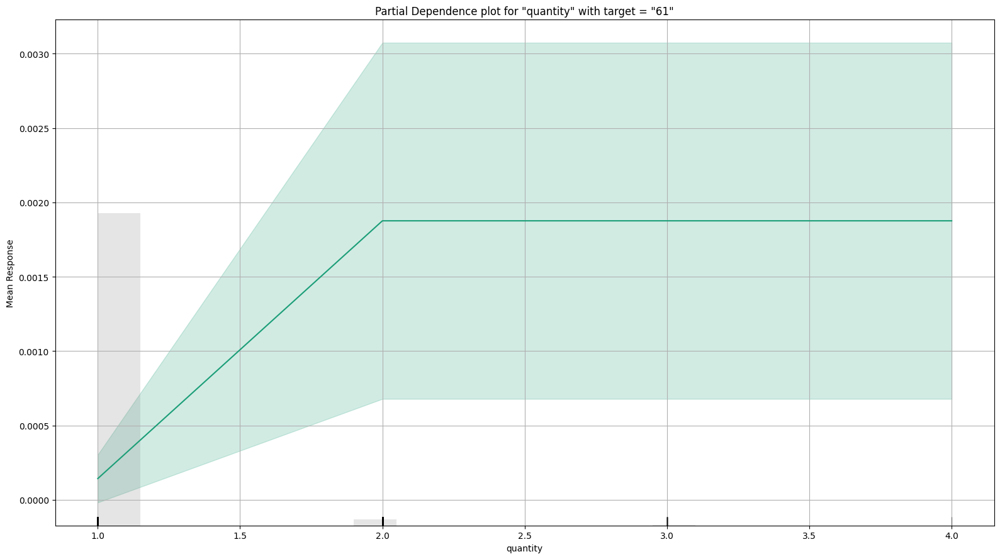

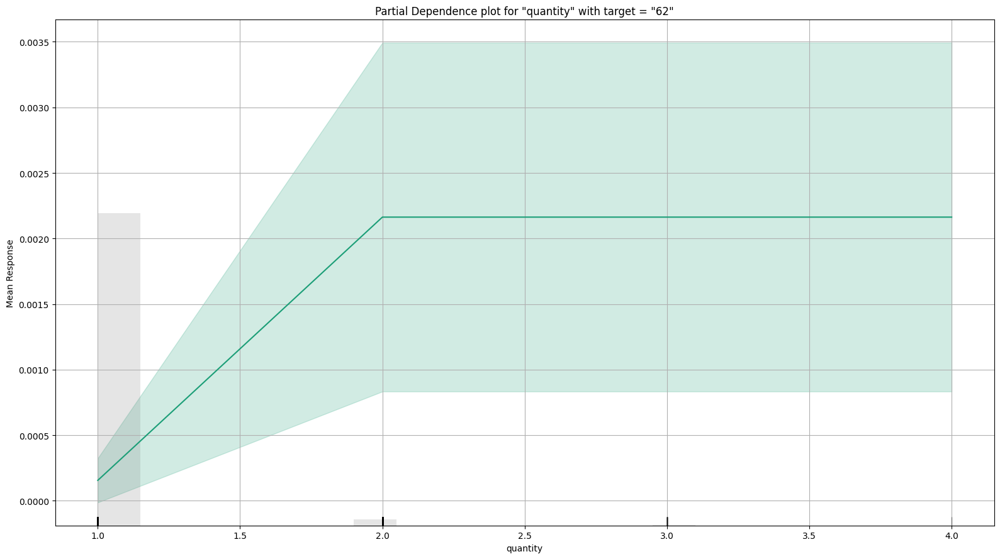

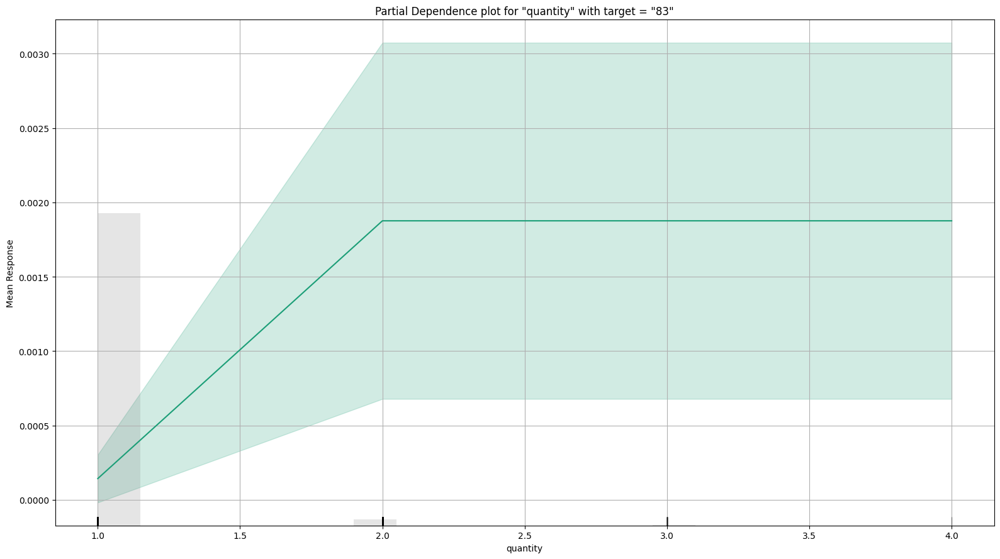

In [53]:
best_model.explain(data_train)

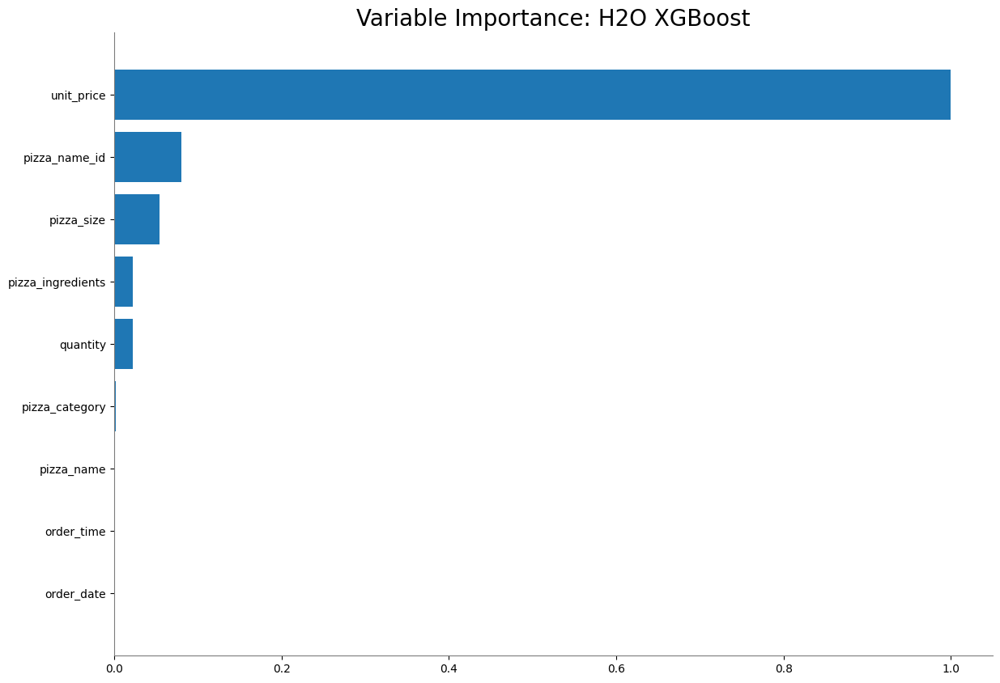

<Figure size 50000x10000 with 0 Axes>

In [54]:
if best_model.algo in ['gbm','drf','xrt','xgboost']:
  best_model.varimp_plot()

In [60]:
def model_performance_stats(perf):
    d={}
    try:
      d['mse']=perf.mse()
    except:
      pass
    try:
      d['rmse']=perf.rmse()
    except:
      pass
    try:
      d['null_degrees_of_freedom']=perf.null_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_degrees_of_freedom']=perf.residual_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_deviance']=perf.residual_deviance()
    except:
      pass
    try:
      d['null_deviance']=perf.null_deviance()
    except:
      pass
    try:
      d['aic']=perf.aic()
    except:
      pass
    try:
      d['logloss']=perf.logloss()
    except:
      pass
    try:
      d['auc']=perf.auc()
    except:
      pass
    try:
      d['gini']=perf.gini()
    except:
      pass
    return d

In [61]:
mod_perf=best_model.model_performance(data_test)
stats_test={}
stats_test=model_performance_stats(mod_perf)
stats_test

{'mse': 0.007101261039103316,
 'rmse': 0.08426898028992232,
 'null_degrees_of_freedom': None,
 'residual_degrees_of_freedom': None,
 'residual_deviance': None,
 'null_deviance': None,
 'aic': 'NaN',
 'logloss': 0.03640850159433627,
 'auc': 'NaN'}

**Initialising the shap analysis on the model from step 1,2,3**

In [62]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 3.4 MB/s eta 0:00:00


In [63]:
import shap

In [65]:
lg_explainer = shap.Explainer(linear_reg, x_train)
shap_values_lg = lg_explainer(x_test)

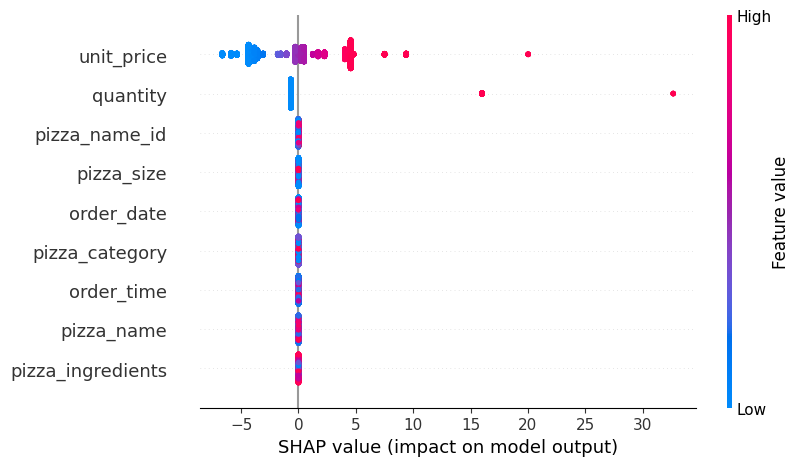

In [66]:
shap.plots.beeswarm(shap_values_lg, max_display=15)

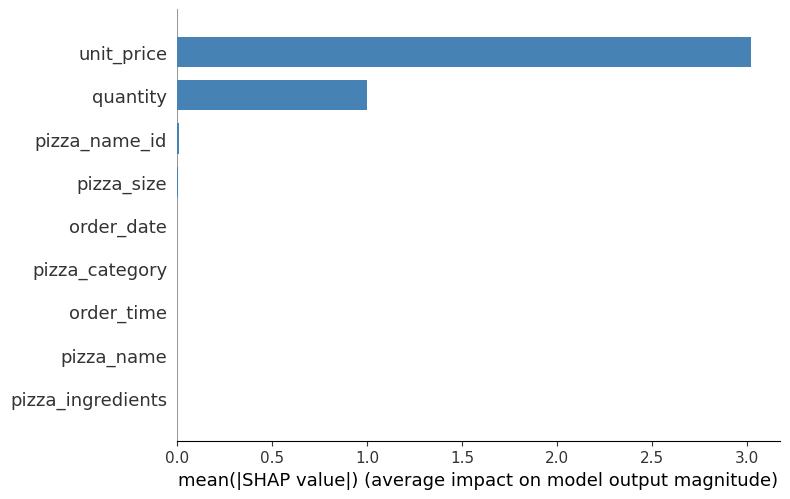

In [67]:
shap.summary_plot(shap_values_lg, x_train, plot_type="bar", color='steelblue')

In [68]:
explainer = shap.TreeExplainer(xgb_reg)
shap_values = explainer.shap_values(x_train,approximate=False, check_additivity=False)

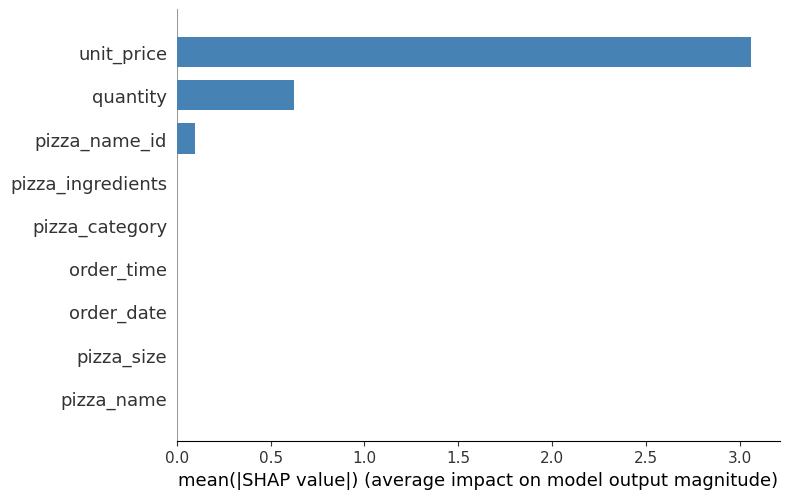

In [69]:
shap.summary_plot(shap_values, x_train, plot_type="bar", color='steelblue')

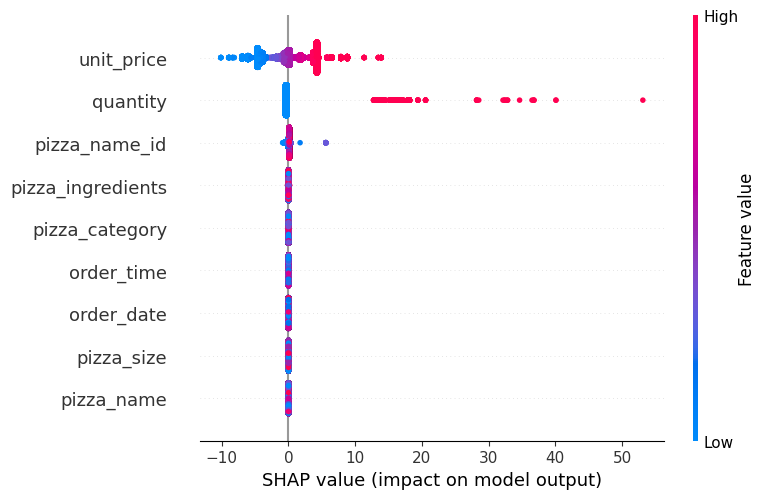

In [70]:
shap.summary_plot(shap_values, x_train)

# **References**

1)https://towardsdatascience.com/interpreting-coefficients-in-linear-and-logistic-regression-6ddf1295f6f1

2)https://towardsdatascience.com/decision-trees-explained-3ec41632ceb6

3)https://www.analyticsvidhya.com/blog/2020/05/decision-tree-vs-random-forest-algorithm/

4)https://www.analyticsvidhya.com/blog/2020/10/all-about-decision-tree-from-scratch-with-python-implementation/

5)https://www.kdnuggets.com/2020/04/visualizing-decision-trees-python.html

6)https://www.datacamp.com/community/tutorials/xgboost-in-python

7)https://github.com/MayurAvinash/DESM_INFO6105/blob/main/Model_Interpretability_Assignment.ipynb

# **LICENSE**

MIT License

Copyright (c) 2024 sakshiraade

Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.